In [1]:
import os
import numpy as np
import pandas as pd
import nibabel as nib
import matplotlib.pyplot as plt
from pathlib import Path

# Plot settings
plt.rcParams["figure.figsize"] = (12, 6)

# Define paths relative to the notebook location
# Assuming notebook is in dlvr-project/notebooks/
project_root = Path("..").resolve()
d2_root = project_root / "data" / "UT-EndoMRI" / "D2_TCPW"

print(f"Project Root: {project_root}")
print(f"Data Root: {d2_root}")

# The 'Golden List' of 37 candidates you provided
CANDIDATE_IDS = [
    "D2-051", "D2-027", "D2-048", "D2-014", "D2-012", "D2-044", "D2-073", "D2-016", 
    "D2-047", "D2-059", "D2-019", "D2-043", "D2-029", "D2-061", "D2-025", "D2-015", 
    "D2-046", "D2-055", "D2-052", "D2-018", "D2-057", "D2-028", "D2-010", "D2-001", 
    "D2-024", "D2-026", "D2-058", "D2-021", "D2-038", "D2-020", "D2-023", "D2-065", 
    "D2-007", "D2-060", "D2-005", "D2-022", "D2-017"
]

CANDIDATE_IDS.sort()
print(f"Loaded {len(CANDIDATE_IDS)} candidates.")

Project Root: C:\Users\lytten\programming\dlvr-project
Data Root: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW
Loaded 37 candidates.


In [2]:
def validate_patient_integrity(pid, root_path):
    """
    Checks if a patient has valid matching T2FS and OV files.
    Returns: 
        is_valid (bool): True if passes all checks
        data (dict): Contains paths and image objects if valid, or error details
    """
    patient_dir = root_path / pid
    t2fs_path = patient_dir / f"{pid}_T2FS.nii.gz"
    ov_path = patient_dir / f"{pid}_ov.nii.gz"
    
    # 1. Existence Check
    if not t2fs_path.exists():
        return False, {"error": "Missing T2FS file"}
    if not ov_path.exists():
        return False, {"error": "Missing OV mask file"}
        
    try:
        # Load Nifti objects (don't load data into memory yet, just headers)
        img_nii = nib.load(str(t2fs_path))
        msk_nii = nib.load(str(ov_path))
        
        # 2. Shape Check
        # We enforce exact shape match. 
        # If they differ, we can't stack them easily in a tensor later.
        if img_nii.shape != msk_nii.shape:
            return False, {
                "error": f"Shape Mismatch: Img {img_nii.shape} vs Mask {msk_nii.shape}"
            }
            
        # 3. Affine Check
        # The affine matrix defines the position in physical space.
        # We use a small tolerance because floating point errors happen.
        if not np.allclose(img_nii.affine, msk_nii.affine, atol=1e-3):
            return False, {
                "error": "Affine Mismatch: Headers indicate different coordinate systems."
            }
            
        return True, {
            "pid": pid,
            "t2fs_path": str(t2fs_path),
            "ov_path": str(ov_path),
            "shape": img_nii.shape
        }
        
    except Exception as e:
        return False, {"error": f"Corrupt file or load error: {str(e)}"}

# Run the validation
valid_patients = []
rejected_patients = []

print("Running technical validation...")
for pid in CANDIDATE_IDS:
    is_valid, info = validate_patient_integrity(pid, d2_root)
    if is_valid:
        valid_patients.append(info)
    else:
        rejected_patients.append({"pid": pid, **info})

print("-" * 30)
print(f"Passed: {len(valid_patients)}")
print(f"Failed: {len(rejected_patients)}")

if rejected_patients:
    print("\nREJECTED PATIENTS:")
    for p in rejected_patients:
        print(f"{p['pid']}: {p['error']}")
else:
    print("\nExcellent. All candidates passed technical header checks.")

Running technical validation...
------------------------------
Passed: 37
Failed: 0

Excellent. All candidates passed technical header checks.


Generating visual QC for 37 patients...


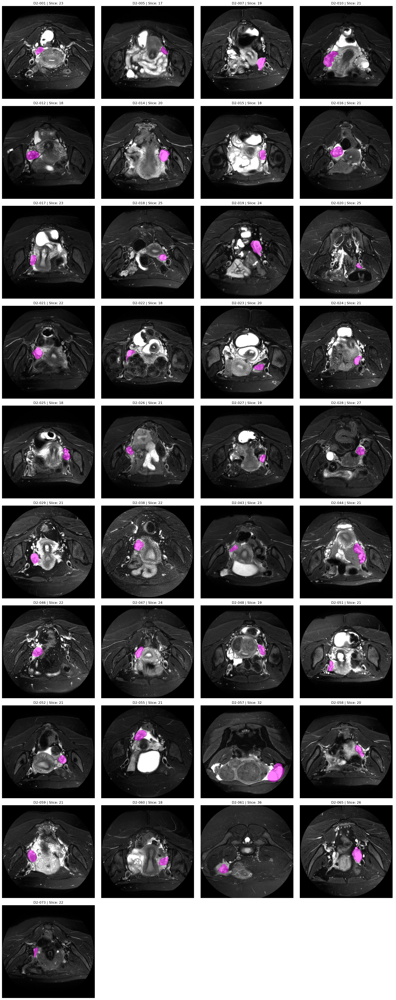

In [3]:
def load_and_find_best_slice(row):
    """
    Loads data and finds the slice index with the largest mask area.
    """
    img = nib.load(row['t2fs_path']).get_fdata()
    msk = nib.load(row['ov_path']).get_fdata()
    
    # Normalize image for display (0-1 range)
    img = np.clip(img, np.percentile(img, 1), np.percentile(img, 99))
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)
    
    # Find slice with max mask pixels
    # Mask shape is (H, W, D) usually
    z_sums = np.sum(msk, axis=(0, 1))
    best_slice_idx = np.argmax(z_sums)
    
    # If mask is completely empty
    if z_sums[best_slice_idx] == 0:
        return None, None, None, "Empty Mask"
        
    return img[:, :, best_slice_idx], msk[:, :, best_slice_idx], best_slice_idx, "OK"

# Create a big grid
import math

if len(valid_patients) > 0:
    n_cols = 4
    n_rows = math.ceil(len(valid_patients) / n_cols)
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
    axes = axes.flatten()
    
    print(f"Generating visual QC for {len(valid_patients)} patients...")
    
    for i, patient_data in enumerate(valid_patients):
        ax = axes[i]
        pid = patient_data['pid']
        
        img_slice, msk_slice, slice_idx, status = load_and_find_best_slice(patient_data)
        
        if status != "OK":
            ax.text(0.5, 0.5, f"{pid}\n{status}", ha='center', va='center')
            ax.set_title(f"{pid} - FAIL")
        else:
            # Rotate 90 degrees if needed (MRI is often rotated in numpy arrays)
            # Usually MRI loaded via nibabel is rotated 90 deg relative to matplotlib imshow
            img_show = np.rot90(img_slice)
            msk_show = np.rot90(msk_slice)
            
            ax.imshow(img_show, cmap='gray')
            
            # Overlay mask
            # Create a custom colormap or use masked array
            masked_overlay = np.ma.masked_where(msk_show == 0, msk_show)
            ax.imshow(masked_overlay, cmap='spring', alpha=0.5)
            
            ax.set_title(f"{pid} | Slice: {slice_idx}")
            
        ax.axis('off')
        
    # Turn off unused axes
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
        
    plt.tight_layout()
    plt.show()
else:
    print("No valid patients to plot.")

In [4]:
if len(valid_patients) > 0:
    df_clean = pd.DataFrame(valid_patients)
    
    # Reorder columns nicely
    df_clean = df_clean[['pid', 't2fs_path', 'ov_path', 'shape']]
    
    out_path = project_root / "data" / "d2_final_37_verified.csv"
    df_clean.to_csv(out_path, index=False)
    
    print(f"Saved verified manifest to: {out_path}")
    print("Use this CSV for all future data loading.")
    display(df_clean.head())

Saved verified manifest to: C:\Users\lytten\programming\dlvr-project\data\d2_final_37_verified.csv
Use this CSV for all future data loading.


,pid,t2fs_path,ov_path,shape
0,D2-001,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,"(320, 320, 34)"
1,D2-005,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,"(320, 320, 34)"
2,D2-007,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,"(352, 352, 34)"
3,D2-010,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,"(352, 352, 34)"
4,D2-012,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,"(352, 352, 36)"


In [7]:
def check_midline_overlap_corrected(row):
    """
    Determines if the mask crosses the vertical center (Left-Right axis) of the image.
    CORRECTED: Uses Axis 0 (Width/Left-Right) instead of Axis 1.
    """
    msk_nii = nib.load(row['ov_path'])
    msk_data = msk_nii.get_fdata()
    
    # Axis 0 is usually Left-Right in these NIfTIs
    width_lr = msk_data.shape[0]
    midline = width_lr // 2
    
    # Get all coordinates where mask > 0
    # coords returns (x, y, z)
    coords = np.argwhere(msk_data > 0)
    
    if len(coords) == 0:
        return "Empty", None, None
    
    # Check x-coordinates (axis 0)
    x_coords = coords[:, 0]
    min_x = x_coords.min()
    max_x = x_coords.max()
    
    # Check for crossing
    crosses_midline = (min_x < midline) and (max_x > midline)
    
    # Determine side based on center of mass
    center_x = (min_x + max_x) / 2
    
    # If center is lower than midline, it's on the "Left" (indices 0 to mid)
    # Note: "Left" here refers to array indices, not necessarily patient left/right yet.
    side = "SIDE_A" if center_x < midline else "SIDE_B"
    
    return "OK" if not crosses_midline else "CROSSES", side, midline

# Run the check
clean_split_candidates = []
excluded_split_candidates = []

print("Checking for midline overlap (Corrected Axis 0)...")
for idx, row in df_clean.iterrows():
    status, side, midline = check_midline_overlap_corrected(row)
    
    info = row.to_dict()
    info['side'] = side
    info['midline'] = midline
    
    if status == "OK":
        clean_split_candidates.append(info)
    else:
        excluded_split_candidates.append(info)

print("-" * 30)
print(f"Total Verified Candidates: {len(df_clean)}")
print(f"Safe to Split: {len(clean_split_candidates)}")
print(f"Excluded (Crosses Midline): {len(excluded_split_candidates)}")

if excluded_split_candidates:
    print("\nPatients excluded due to midline overlap:")
    for p in excluded_split_candidates:
        print(f"{p['pid']}")
else:
    print("\nGreat! No patients cross the Left-Right midline.")

Checking for midline overlap (Corrected Axis 0)...
------------------------------
Total Verified Candidates: 37
Safe to Split: 37
Excluded (Crosses Midline): 0

Great! No patients cross the Left-Right midline.


Visualizing split plan (Logic Inverted) for first 8 candidates...


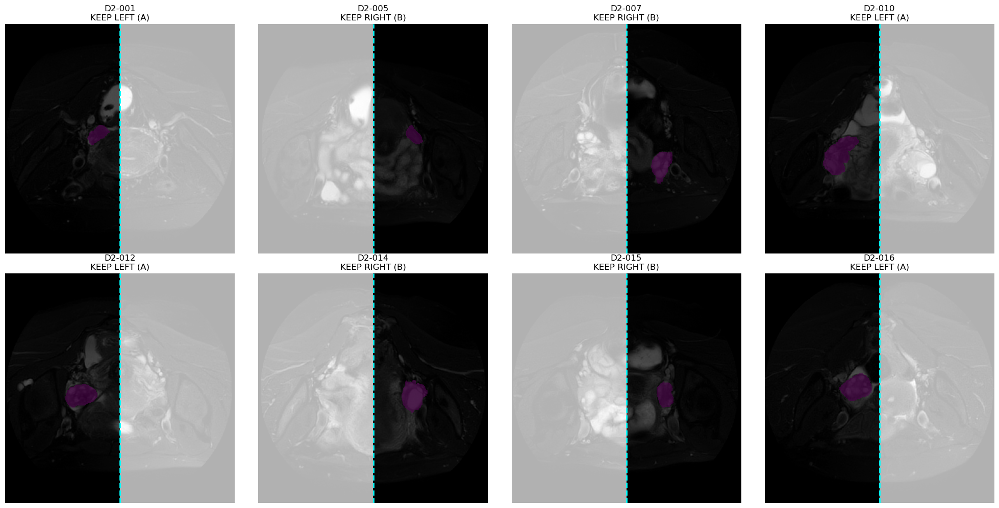

In [9]:
def visualize_split_plan_fixed(candidates, num_samples=8):
    to_plot = candidates[:num_samples] if len(candidates) > num_samples else candidates
    
    n_cols = 4
    n_rows = math.ceil(len(to_plot) / n_cols)
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))
    axes = axes.flatten()
    
    print(f"Visualizing split plan (Logic Inverted) for first {len(to_plot)} candidates...")
    
    for i, row in enumerate(to_plot):
        ax = axes[i]
        
        img = nib.load(row['t2fs_path']).get_fdata()
        msk = nib.load(row['ov_path']).get_fdata()
        
        z_sums = np.sum(msk, axis=(0, 1))
        best_slice = np.argmax(z_sums)
        
        img_slice = img[:, :, best_slice]
        msk_slice = msk[:, :, best_slice]
        
        # Normalize
        img_slice = (img_slice - img_slice.min()) / (img_slice.max() - img_slice.min() + 1e-8)
        
        # Transpose for display (X=LR, Y=AP)
        img_show = img_slice.T
        msk_show = msk_slice.T
        
        ax.imshow(img_show, cmap='gray', origin='lower')
        
        masked_overlay = np.ma.masked_where(msk_show == 0, msk_show)
        ax.imshow(masked_overlay, cmap='spring', alpha=0.6, origin='lower')
        
        mid = row['midline']
        ax.axvline(x=mid, color='cyan', linestyle='--', linewidth=2)
        
        # --- FIXED BLACKOUT LOGIC ---
        blackout_mask = np.zeros_like(img_slice)
        
        # Based on the previous plot:
        # 'mid:' mapped to Left. ':mid' mapped to Right.
        # If Side A (Left), we want to blackout Right -> Use ':mid'
        # If Side B (Right), we want to blackout Left -> Use 'mid:'
        
        if row['side'] == "SIDE_A":
            # Mask is on Left. Keep Left. Blackout Right.
            # Inverted logic: Right seems to be 0..mid based on visual feedback
            blackout_mask[:mid, :] = 1
            title_text = "KEEP LEFT (A)"
        else:
            # Mask is on Right. Keep Right. Blackout Left.
            blackout_mask[mid:, :] = 1
            title_text = "KEEP RIGHT (B)"
            
        ax.imshow(blackout_mask.T, cmap='binary', alpha=0.7, origin='lower', vmin=0, vmax=1)
        
        ax.set_title(f"{row['pid']}\n{title_text}")
        ax.axis('off')

    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

if clean_split_candidates:
    visualize_split_plan_fixed(clean_split_candidates)

Generating full slice verification for 37 patients...
Legend: Grey = Blacked out area. Pink = Ovary Mask. Cyan = Midline.


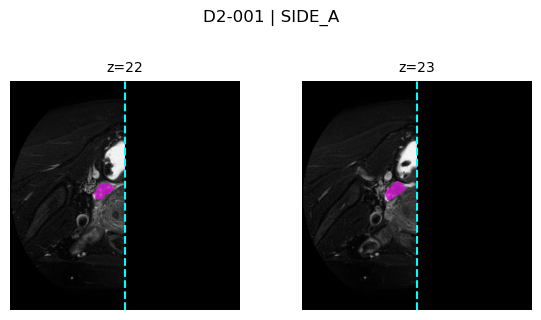

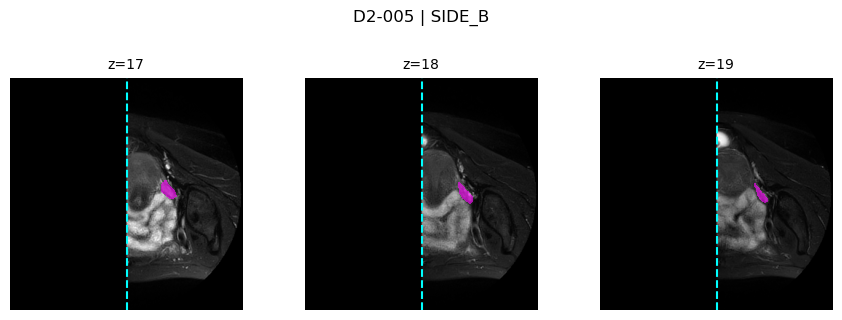

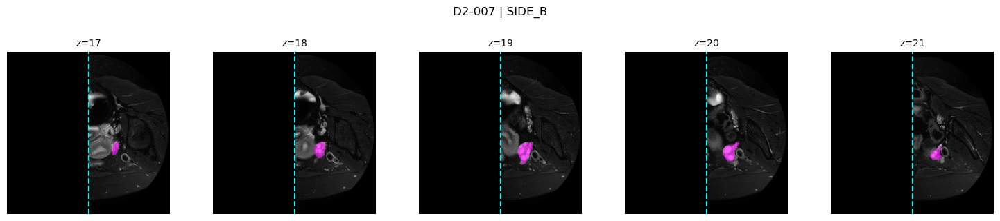

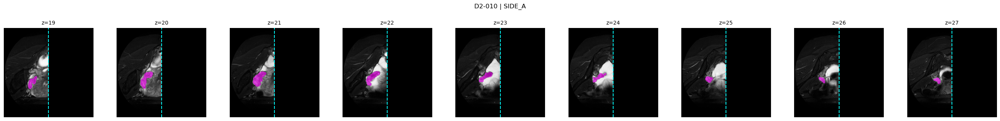

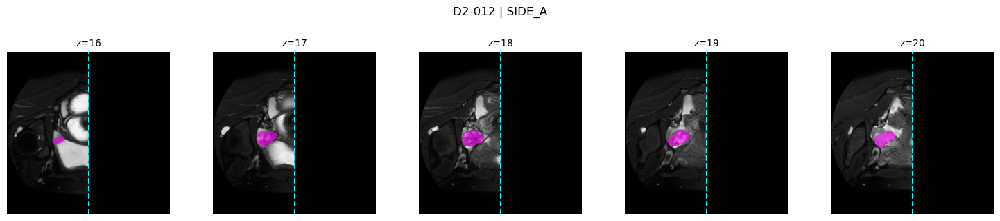

...

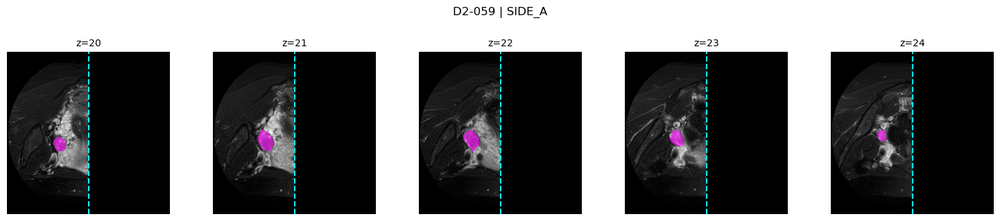

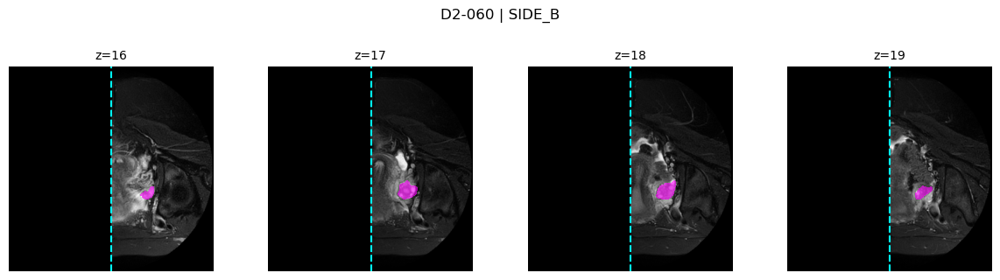

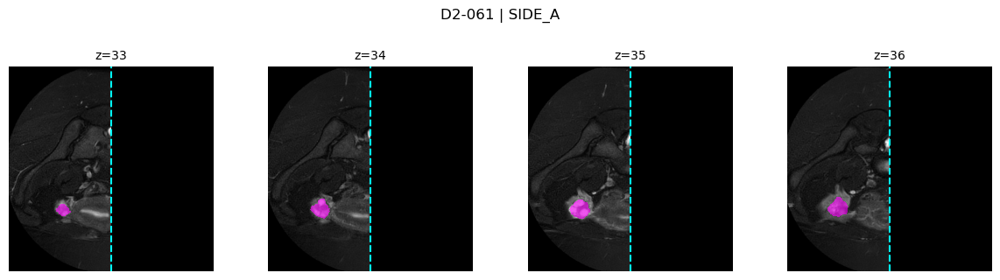

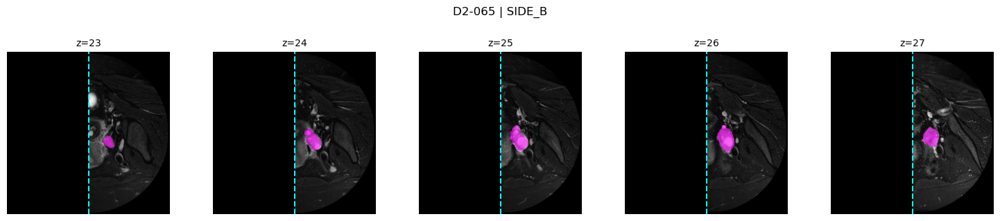

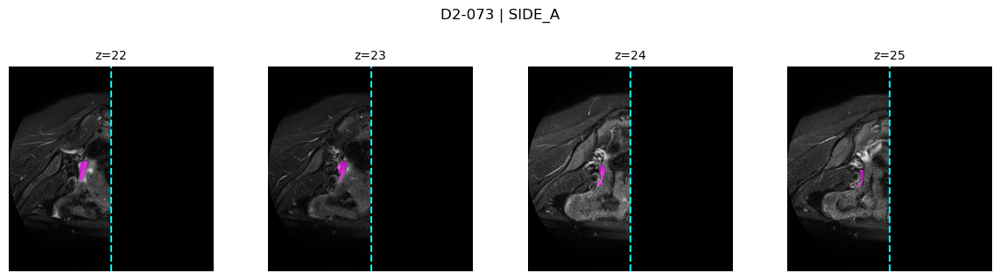

In [11]:
def visualize_all_mask_slices_final(candidates):
    print(f"Generating full slice verification for {len(candidates)} patients...")
    print("Legend: Grey = Blacked out area. Pink = Ovary Mask. Cyan = Midline.")
    
    for row in candidates:
        pid = row['pid']
        mid = row['midline']
        side = row['side']
        
        # Load data
        img = nib.load(row['t2fs_path']).get_fdata()
        msk = nib.load(row['ov_path']).get_fdata()
        
        # --- FINAL CORRECTED LOGIC ---
        # D2-001 is SIDE_A (Left/Indices 0..mid). 
        # Previous run killed [:mid] which killed the ovary.
        # CORRECT LOGIC:
        # If SIDE_A: Keep [:mid]. Kill [mid:].
        
        img_blacked = img.copy()
        
        if side == "SIDE_A":
            # Ovary is in 0..mid. Blackout the OTHER side (mid..end).
            img_blacked[mid:, :, :] = 0
        else:
            # Ovary is in mid..end. Blackout the OTHER side (0..mid).
            img_blacked[:mid, :, :] = 0
            
        # Find slices with mask
        z_sums = np.sum(msk, axis=(0, 1))
        active_slices = np.where(z_sums > 0)[0]
        
        if len(active_slices) == 0: continue
            
        # Limit to 10 slices
        if len(active_slices) > 10:
            start = len(active_slices) // 2 - 5
            display_slices = active_slices[start : start+10]
        else:
            display_slices = active_slices
            
        n_slices = len(display_slices)
        fig, axes = plt.subplots(1, n_slices, figsize=(3 * n_slices, 3))
        if n_slices == 1: axes = [axes]
            
        fig.suptitle(f"{pid} | {side}", fontsize=12, y=1.05)
        
        for ax, z_idx in zip(axes, display_slices):
            img_slice = img_blacked[:, :, z_idx]
            msk_slice = msk[:, :, z_idx]
            
            # Normalize
            img_slice = (img_slice - img_slice.min()) / (img_slice.max() - img_slice.min() + 1e-8)
            
            # Transpose for display
            ax.imshow(img_slice.T, cmap='gray', origin='lower')
            
            # Overlay mask
            masked_overlay = np.ma.masked_where(msk_slice.T == 0, msk_slice.T)
            ax.imshow(masked_overlay, cmap='spring', alpha=0.6, origin='lower')
            
            ax.axvline(x=mid, color='cyan', linestyle='--')
            ax.set_title(f"z={z_idx}", fontsize=10)
            ax.axis('off')
            
        plt.tight_layout()
        plt.show()

if clean_split_candidates:
    visualize_all_mask_slices_final(clean_split_candidates)

In [12]:
def create_split_dataset_final(candidates, output_dir):
    out_path = Path(output_dir)
    out_path.mkdir(parents=True, exist_ok=True)
    
    new_manifest_rows = []
    
    print(f"Generating FINAL split dataset in {out_path}...")
    
    for row in candidates:
        pid = row['pid']
        mid = row['midline']
        side = row['side']
        
        img_nii = nib.load(row['t2fs_path'])
        msk_nii = nib.load(row['ov_path'])
        img_data = img_nii.get_fdata()
        
        # Apply Logic
        new_img_data = img_data.copy()
        
        if side == "SIDE_A":
            # Keep A (0..mid). Kill B (mid..end).
            new_img_data[mid:, :, :] = 0
        else:
            # Keep B (mid..end). Kill A (0..mid).
            new_img_data[:mid, :, :] = 0
            
        # Save
        new_img_nii = nib.Nifti1Image(new_img_data, img_nii.affine, img_nii.header)
        
        new_img_filename = f"{pid}_T2FS_half.nii.gz"
        new_msk_filename = f"{pid}_ov.nii.gz"
        
        new_img_path = out_path / new_img_filename
        new_msk_path = out_path / new_msk_filename
        
        nib.save(new_img_nii, new_img_path)
        nib.save(msk_nii, new_msk_path)
        
        new_manifest_rows.append({
            'pid': pid,
            't2fs_path': str(new_img_path),
            'ov_path': str(new_msk_path),
            'original_side': side,
            'split_type': 'half_blackout_final'
        })
        
    df_split = pd.DataFrame(new_manifest_rows)
    manifest_path = out_path / "d2_half_split_manifest.csv"
    df_split.to_csv(manifest_path, index=False)
    
    print(f"Done. Processed {len(new_manifest_rows)} patients.")
    return df_split

if clean_split_candidates:
    NEW_DATASET_DIR = project_root / "data" / "UT-EndoMRI" / "D2_Half_Split"
    # Run generation
    df_final_split = create_split_dataset_final(clean_split_candidates, NEW_DATASET_DIR)
    display(df_final_split.head())

Generating FINAL split dataset in C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_Half_Split...
Done. Processed 37 patients.


,pid,t2fs_path,ov_path,original_side,split_type
0,D2-001,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_A,half_blackout_final
1,D2-005,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_B,half_blackout_final
2,D2-007,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_B,half_blackout_final
3,D2-010,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_A,half_blackout_final
4,D2-012,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_A,half_blackout_final


Verifying 37 patients from disk: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_Half_Split


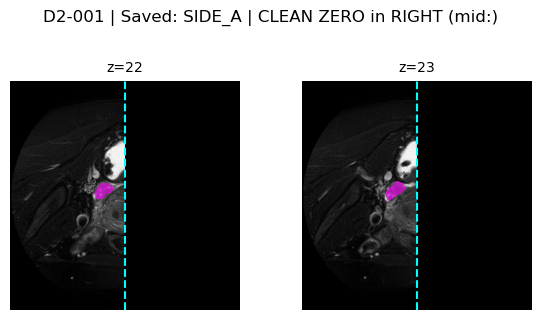

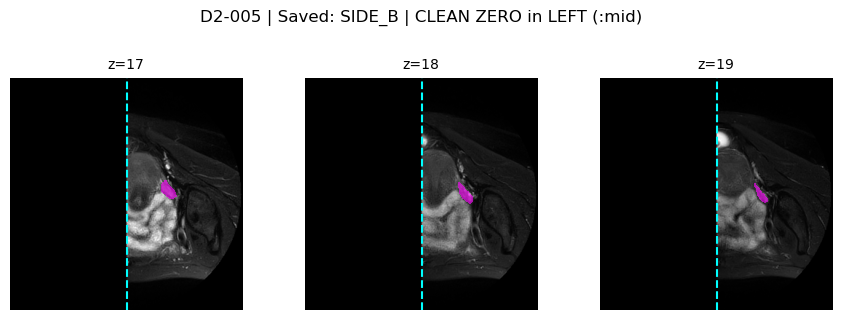

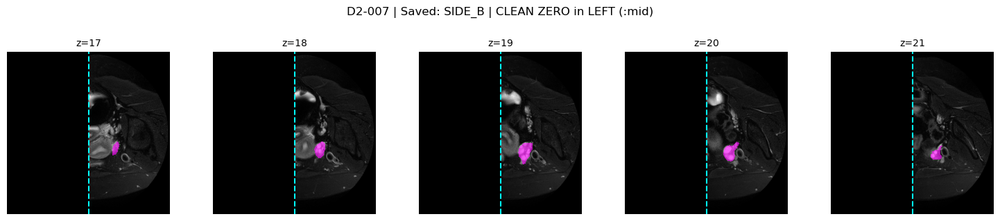

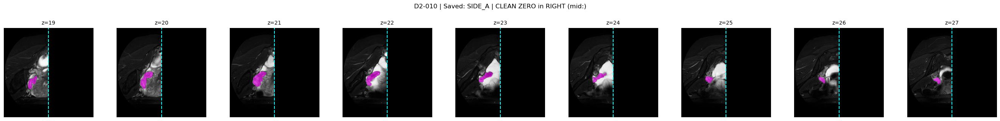

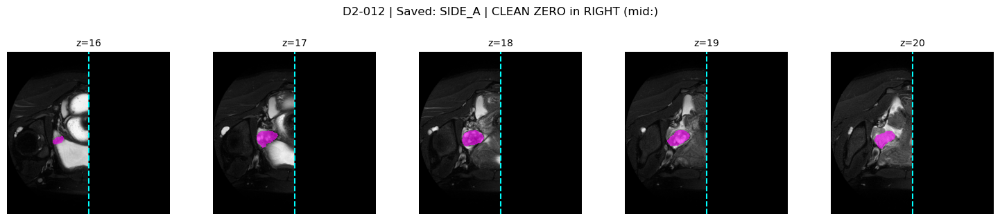

...

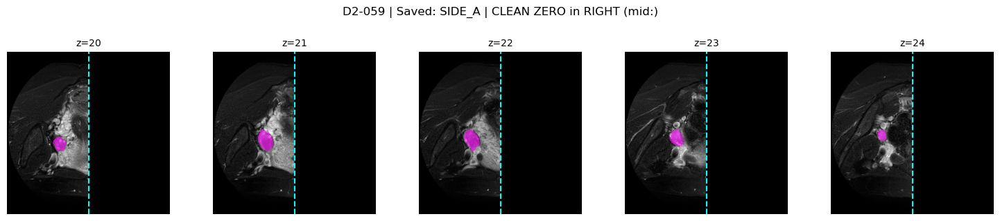

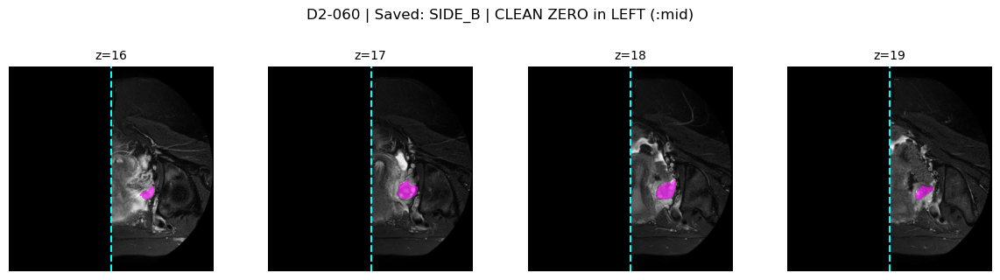

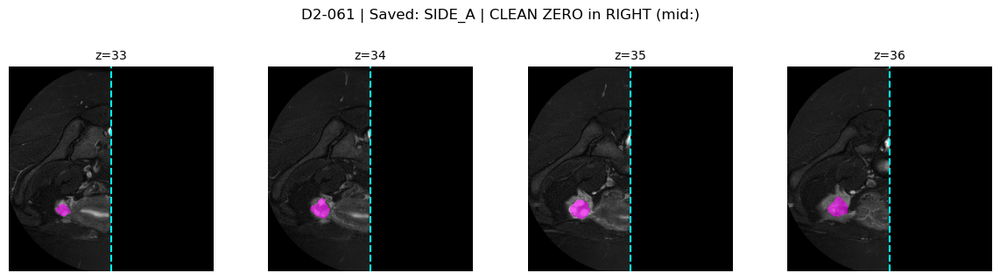

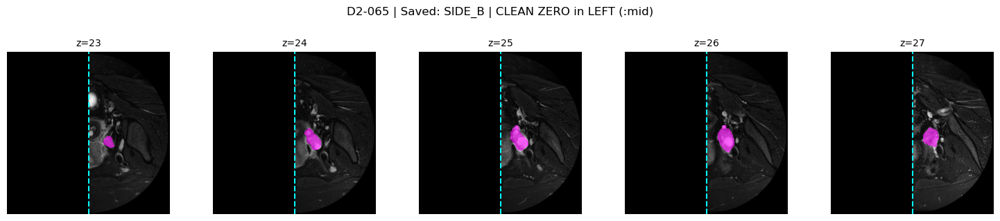

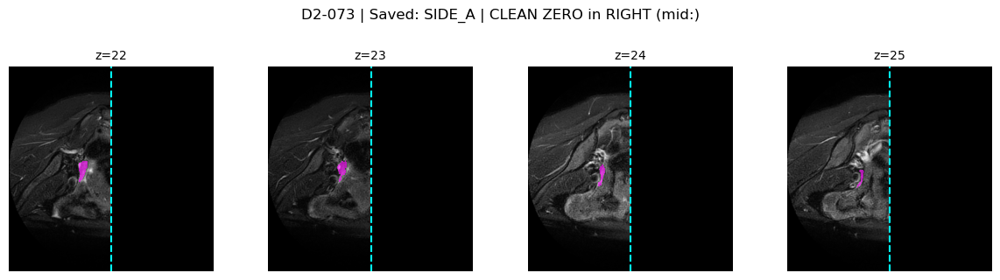

In [13]:
# Cell 8: Final Sanity Check - Verification from Disk
# We load the newly created files to prove they are physically blacked out.

def verify_saved_dataset(manifest_path):
    manifest_path = Path(manifest_path)
    if not manifest_path.exists():
        print(f"CRITICAL: Manifest not found at {manifest_path}")
        return

    df_new = pd.read_csv(manifest_path)
    print(f"Verifying {len(df_new)} patients from disk: {manifest_path.parent}")
    
    for idx, row in df_new.iterrows():
        pid = row['pid']
        side = row['original_side']
        
        # Load from the NEW paths
        img_path = row['t2fs_path']
        msk_path = row['ov_path']
        
        # Handle relative paths if necessary (though they were saved as absolute usually)
        if not Path(img_path).exists():
            # Try relative to manifest
            img_path = manifest_path.parent / Path(img_path).name
            msk_path = manifest_path.parent / Path(msk_path).name
            
        img = nib.load(str(img_path)).get_fdata()
        msk = nib.load(str(msk_path)).get_fdata()
        
        # Recalculate midline (we didn't save it, but it's just half width)
        mid = img.shape[0] // 2
        
        # --- PROGRAMMATIC ZERO CHECK ---
        # Verify the pixels are actually 0.0 in the file
        is_clean = False
        if side == "SIDE_A":
            # We kept A (Left). Expected B (Right) to be 0.
            check_region = img[mid:, :, :]
            region_name = "RIGHT (mid:)"
        else:
            # We kept B (Right). Expected A (Left) to be 0.
            check_region = img[:mid, :, :]
            region_name = "LEFT (:mid)"
            
        total_sum = np.sum(check_region)
        status_msg = "CLEAN ZERO" if total_sum == 0 else f"DIRTY (Sum={total_sum})"
        
        # Find slices with mask
        z_sums = np.sum(msk, axis=(0, 1))
        active_slices = np.where(z_sums > 0)[0]
        
        if len(active_slices) == 0: continue
            
        # Display logic (same as before)
        if len(active_slices) > 10:
            start = len(active_slices) // 2 - 5
            display_slices = active_slices[start : start+10]
        else:
            display_slices = active_slices
            
        n_slices = len(display_slices)
        fig, axes = plt.subplots(1, n_slices, figsize=(3 * n_slices, 3))
        if n_slices == 1: axes = [axes]
            
        fig.suptitle(f"{pid} | Saved: {side} | {status_msg} in {region_name}", fontsize=12, y=1.05)
        
        for ax, z_idx in zip(axes, display_slices):
            img_slice = img[:, :, z_idx] # Raw file data
            msk_slice = msk[:, :, z_idx]
            
            # Normalize for display
            img_disp = (img_slice - img_slice.min()) / (img_slice.max() - img_slice.min() + 1e-8)
            
            ax.imshow(img_disp.T, cmap='gray', origin='lower')
            
            masked_overlay = np.ma.masked_where(msk_slice.T == 0, msk_slice.T)
            ax.imshow(masked_overlay, cmap='spring', alpha=0.6, origin='lower')
            
            ax.axvline(x=mid, color='cyan', linestyle='--')
            ax.set_title(f"z={z_idx}", fontsize=10)
            ax.axis('off')
            
        plt.tight_layout()
        plt.show()

# Run it
new_manifest_loc = project_root / "data" / "UT-EndoMRI" / "D2_Half_Split" / "d2_half_split_manifest.csv"
verify_saved_dataset(new_manifest_loc)

In [17]:
# SANDBOX: Simulation of 5-Fold Balance
# This does NOT save to disk. It just checks the math.

def verify_fold_balance_simulation(manifest_path):
    df = pd.read_csv(manifest_path)
    
    # 1. Get accurate slice counts
    print("Reading slice counts from disk...")
    counts = []
    for _, row in df.iterrows():
        msk = nib.load(row['ov_path']).get_fdata()
        # Count slices with any mask pixels
        counts.append(np.count_nonzero(np.sum(msk, axis=(0,1))))

    df['sim_slices'] = counts
    
    # 2. Sort
    df_sorted = df.sort_values('sim_slices').reset_index(drop=True)
    
    # 3. Assign Folds (0, 1, 2, 3, 4, 0...)
    folds = [i % 5 for i in range(len(df_sorted))]
    df_sorted['sim_fold'] = folds
    
    # 4. Report Stats
    print("\n--- 5-FOLD BALANCE SIMULATION ---")
    overall_mean = df_sorted['sim_slices'].mean()
    print(f"Overall Dataset Average: {overall_mean:.2f} slices/patient\n")
    
    for f in range(5):
        subset = df_sorted[df_sorted['sim_fold'] == f]
        n_pats = len(subset)
        avg = subset['sim_slices'].mean()
        total = subset['sim_slices'].sum()
        
        diff = avg - overall_mean
        
        print(f"Fold {f}: N={n_pats} | Avg={avg:.2f} | Total={total} | Diff from Mean: {diff:+.2f}")

# Run simulation
manifest_loc = project_root / "data" / "UT-EndoMRI" / "D2_Half_Split" / "d2_half_split_manifest.csv"
verify_fold_balance_simulation(manifest_loc)

Reading slice counts from disk...

--- 5-FOLD BALANCE SIMULATION ---
Overall Dataset Average: 4.78 slices/patient

Fold 0: N=8 | Avg=4.75 | Total=38 | Diff from Mean: -0.03
Fold 1: N=8 | Avg=4.75 | Total=38 | Diff from Mean: -0.03
Fold 2: N=7 | Avg=4.57 | Total=32 | Diff from Mean: -0.21
Fold 3: N=7 | Avg=4.86 | Total=34 | Diff from Mean: +0.07
Fold 4: N=7 | Avg=5.00 | Total=35 | Diff from Mean: +0.22


Counting positive slices for stratification...
------------------------------
Stratification Complete. Manifest updated at: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_Half_Split\d2_half_split_manifest.csv
------------------------------
FOLD 0: 8 patients, Avg Slices: 4.8
FOLD 1: 8 patients, Avg Slices: 4.8
FOLD 2: 7 patients, Avg Slices: 4.6
FOLD 3: 7 patients, Avg Slices: 4.9
FOLD 4: 7 patients, Avg Slices: 5.0


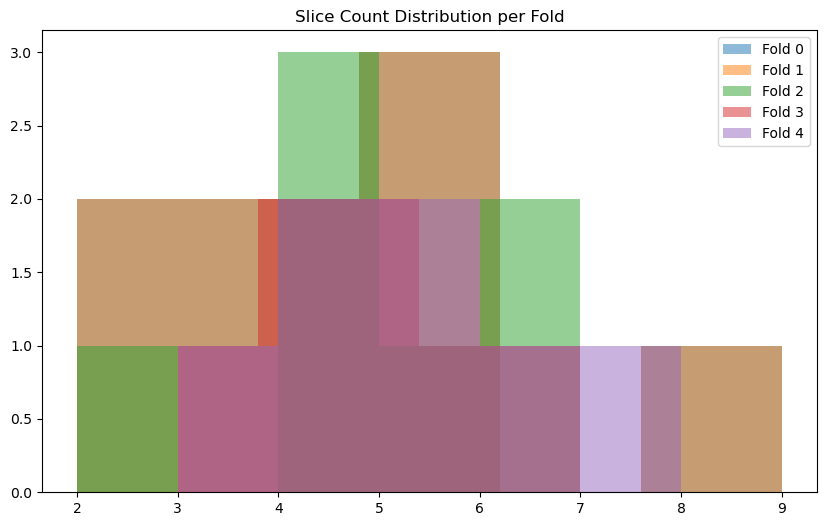

,pid,t2fs_path,ov_path,original_side,split_type,positive_slices,split,fold
0,D2-001,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_A,half_blackout_final,2,test,0
1,D2-015,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_B,half_blackout_final,2,val,1
2,D2-051,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_A,half_blackout_final,2,train,2
3,D2-016,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_A,half_blackout_final,3,train,3
4,D2-047,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,SIDE_A,half_blackout_final,3,train,4


In [18]:
# Cell 9: Stratified K-Fold Assignment
# We assign a Fold ID (0-4) to every patient based on slice count.
# This allows us to do a fixed split NOW, and 5-fold CV LATER.

def create_stratified_folds(manifest_path, k=5):
    df = pd.read_csv(manifest_path)
    
    print("Counting positive slices for stratification...")
    slice_counts = []
    
    for idx, row in df.iterrows():
        msk = nib.load(row['ov_path']).get_fdata()
        z_sums = np.sum(msk, axis=(0, 1))
        num_positive_slices = np.count_nonzero(z_sums)
        slice_counts.append(num_positive_slices)
        
    df['positive_slices'] = slice_counts
    
    # Sort by number of slices to group similar difficulties
    df_sorted = df.sort_values(by='positive_slices').reset_index(drop=True)
    
    # Assign Folds 0 to k-1 in a round-robin fashion
    # Pattern: 0, 1, 2, 3, 4, 0, 1, 2, 3, 4...
    # This ensures every fold gets a mix of easy (few slices) and hard (many slices) cases.
    folds = []
    for i in range(len(df_sorted)):
        folds.append(i % k)
        
    df_sorted['fold'] = folds
    
    # Create a convenience column for our "Development Split" (Fixed)
    # Fold 0 -> Test
    # Fold 1 -> Val
    # Folds 2,3,4 -> Train
    def get_dev_split(fold_id):
        if fold_id == 0: return 'test'
        if fold_id == 1: return 'val'
        return 'train'
    
    df_sorted['split'] = df_sorted['fold'].apply(get_dev_split)
    
    # Save
    df_sorted.to_csv(manifest_path, index=False)
    
    print("-" * 30)
    print(f"Stratification Complete. Manifest updated at: {manifest_path}")
    print("-" * 30)
    
    # Verify Balance across Folds
    for f in range(k):
        subset = df_sorted[df_sorted['fold'] == f]
        n_pats = len(subset)
        avg_slices = subset['positive_slices'].mean()
        print(f"FOLD {f}: {n_pats} patients, Avg Slices: {avg_slices:.1f}")
        
    return df_sorted

# Execute
manifest_loc = project_root / "data" / "UT-EndoMRI" / "D2_Half_Split" / "d2_half_split_manifest.csv"
final_df = create_stratified_folds(manifest_loc)

# Visual check
plt.figure(figsize=(10, 6))
for f in range(5):
    subset = final_df[final_df['fold'] == f]
    plt.hist(subset['positive_slices'], alpha=0.5, label=f"Fold {f}", bins=5)
plt.legend()
plt.title("Slice Count Distribution per Fold")
plt.show()

display(final_df.head())


  TRAIN SET | Folds: [2, 3, 4] | Total Patients: 21



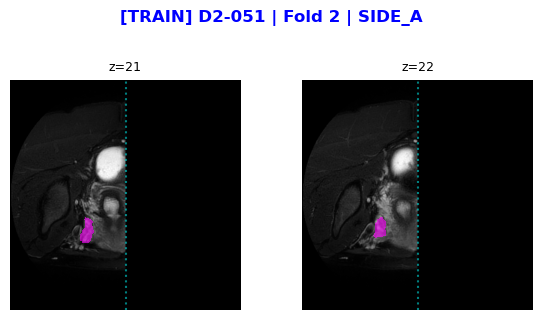

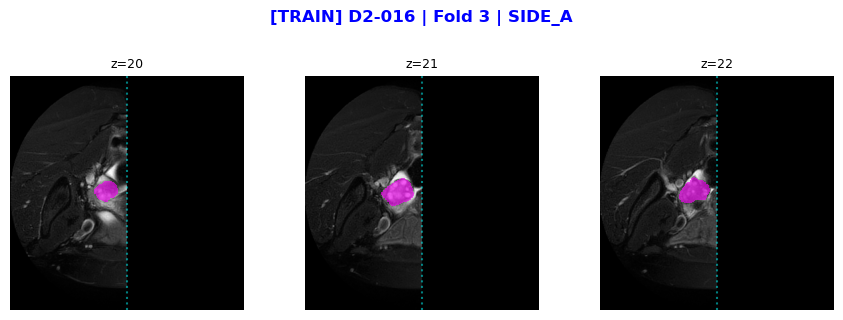

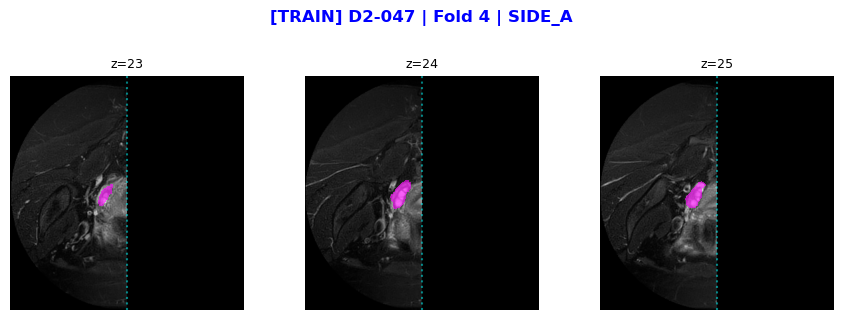

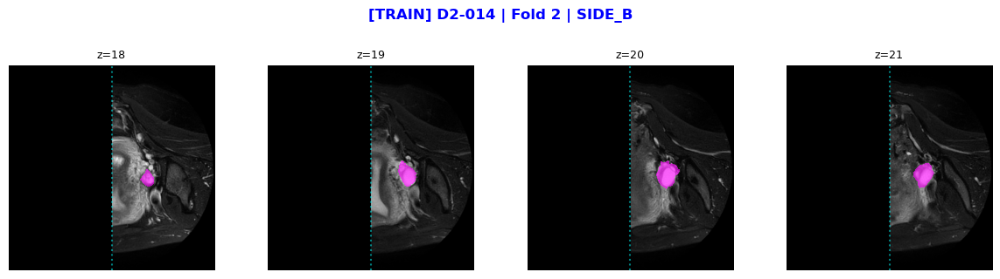

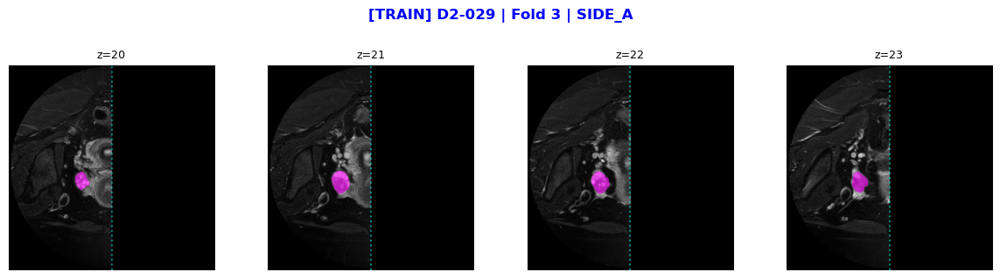

...

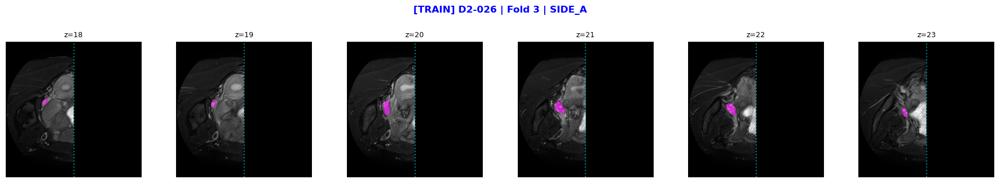

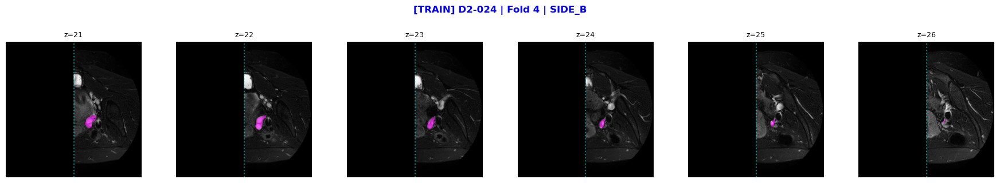

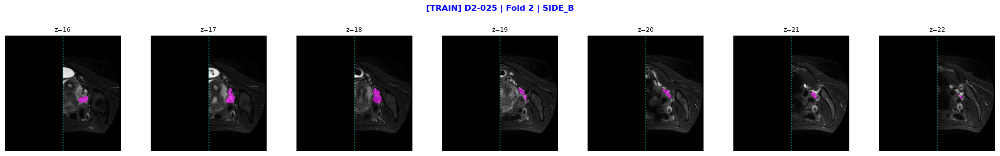

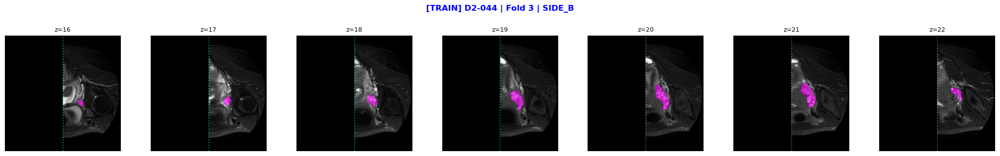

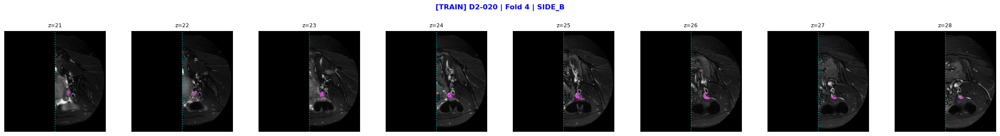


  VAL SET | Folds: [1] | Total Patients: 8



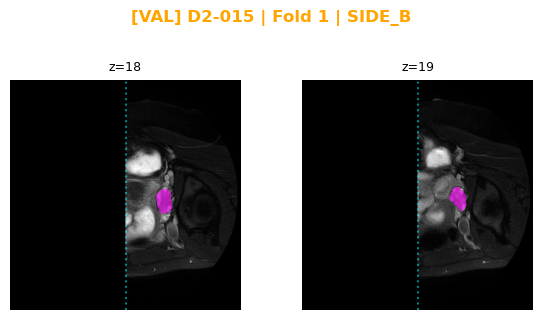

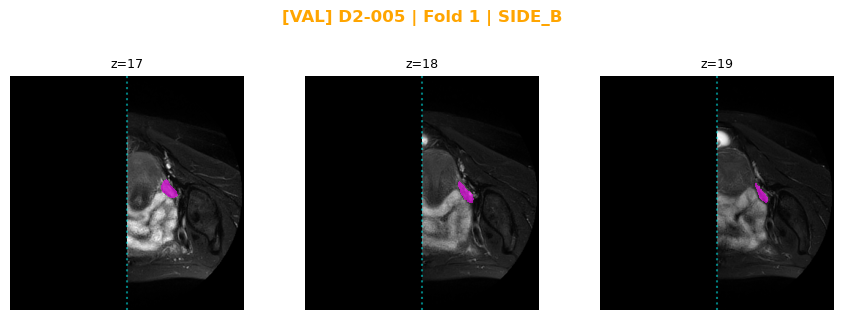

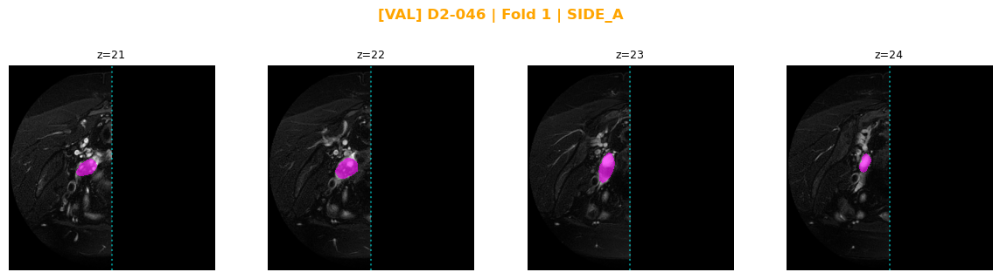

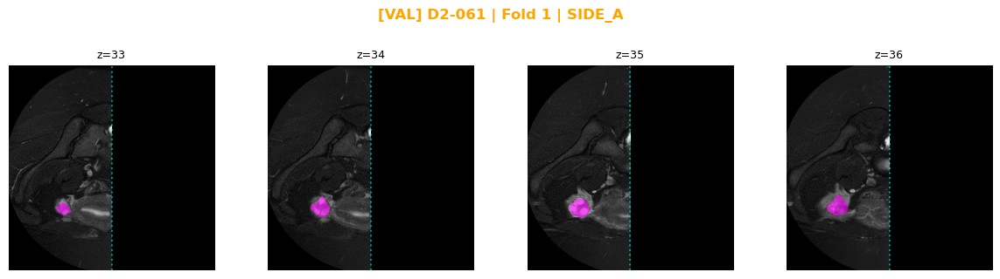

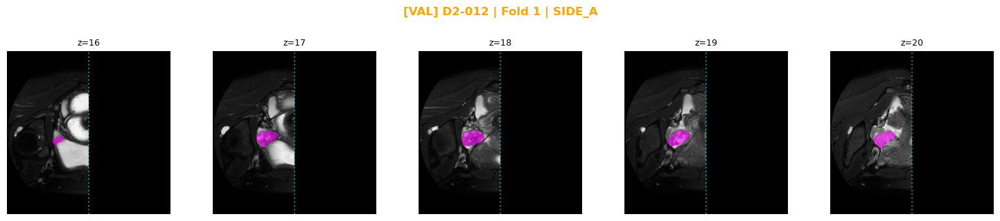

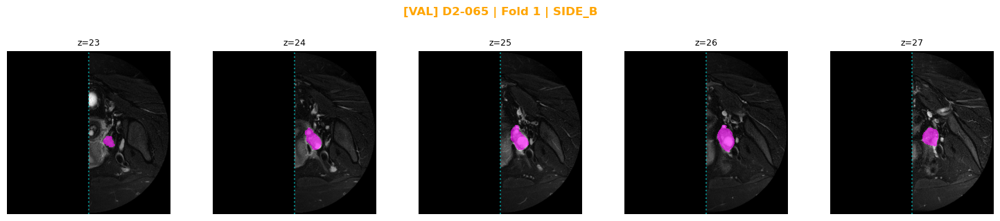

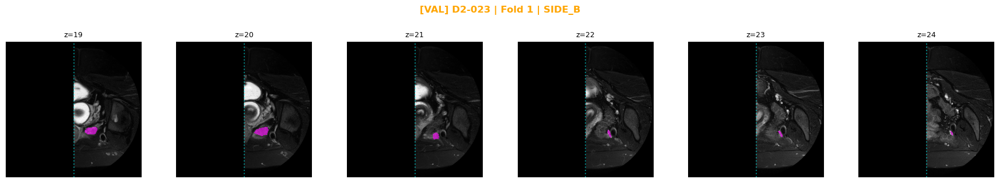

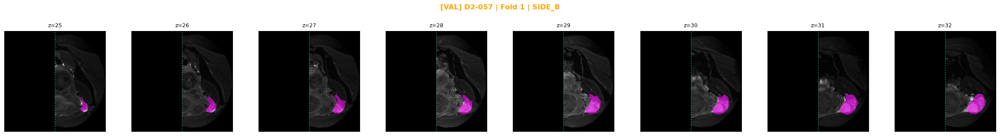


  TEST SET | Folds: [0] | Total Patients: 8



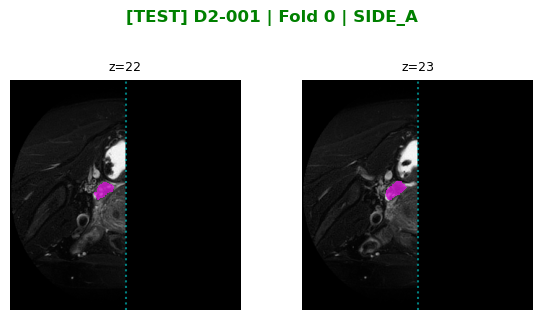

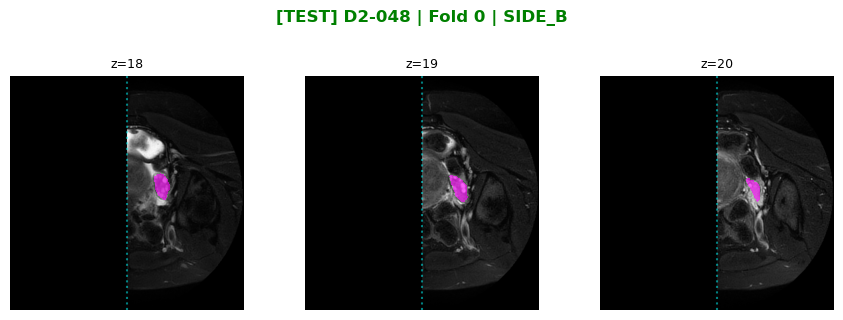

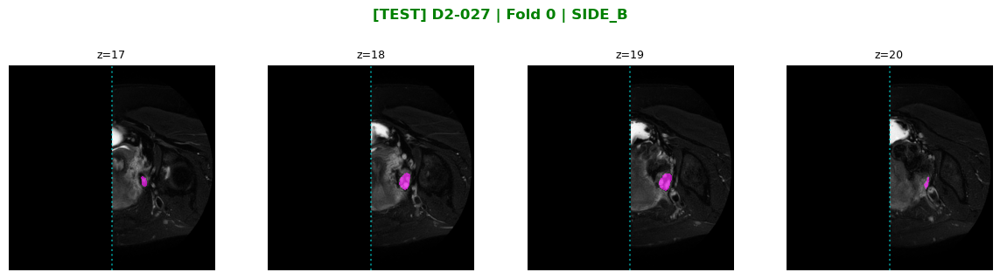

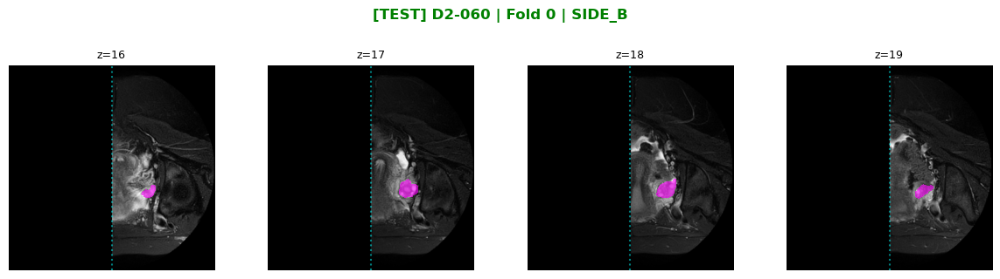

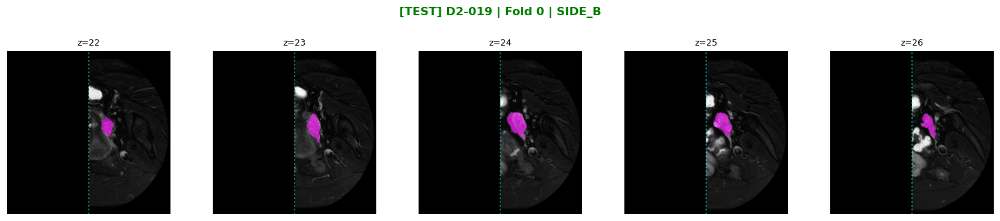

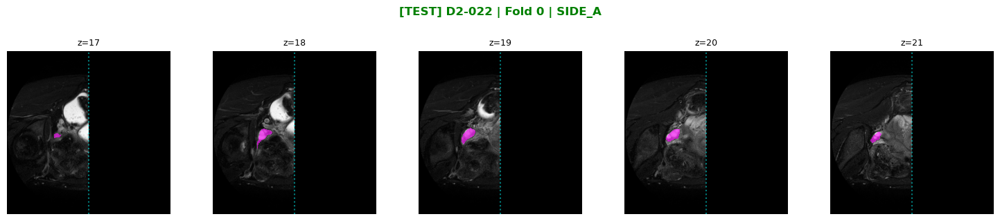

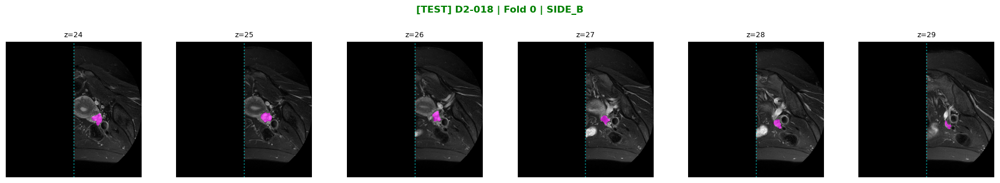

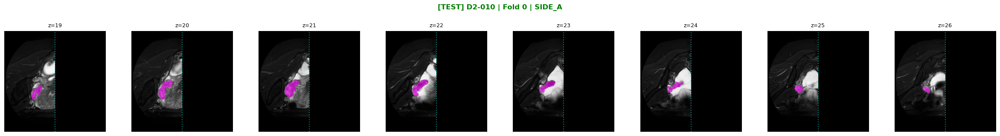

In [20]:
# Cell 10: Final Visual Audit with Explicit Fold Tracking
# We display every patient, grouped by split, and explicitly state which Folds are used.

def visualize_splits_explicit(manifest_path):
    df = pd.read_csv(manifest_path)
    
    # Define colors for headers
    split_colors = {'train': 'blue', 'val': 'orange', 'test': 'green'}
    
    # We explicitly define the order we want to see them
    for split in ['train', 'val', 'test']:
        subset = df[df['split'] == split]
        
        # Identify exactly which folds are in this split
        included_folds = sorted(subset['fold'].unique())
        folds_str = ", ".join(map(str, included_folds))
        
        print("\n" + "="*80)
        print(f"  {split.upper()} SET | Folds: [{folds_str}] | Total Patients: {len(subset)}")
        print("="*80 + "\n")
        
        for idx, row in subset.iterrows():
            pid = row['pid']
            side = row['original_side']
            fold_id = row['fold']
            
            # Load from disk
            img_path = row['t2fs_path']
            msk_path = row['ov_path']
            
            # Path handling (relative vs absolute)
            if not Path(img_path).exists():
                 img_path = Path(manifest_path).parent / Path(img_path).name
                 msk_path = Path(manifest_path).parent / Path(msk_path).name
            
            img = nib.load(str(img_path)).get_fdata()
            msk = nib.load(str(msk_path)).get_fdata()
            mid = img.shape[0] // 2
            
            # Find active slices
            z_sums = np.sum(msk, axis=(0, 1))
            active_slices = np.where(z_sums > 0)[0]
            
            if len(active_slices) == 0:
                print(f"Skipping {pid} (No active slices found)")
                continue
                
            # Limit to max 8 slices
            if len(active_slices) > 8:
                start = len(active_slices) // 2 - 4
                display_slices = active_slices[start : start+8]
            else:
                display_slices = active_slices
                
            n_slices = len(display_slices)
            fig, axes = plt.subplots(1, n_slices, figsize=(3 * n_slices, 3))
            if n_slices == 1: axes = [axes]
            
            # Title: explicitly shows Fold ID
            fig.suptitle(f"[{split.upper()}] {pid} | Fold {fold_id} | {side}", 
                         fontsize=12, y=1.05, color=split_colors[split], fontweight='bold')
            
            for ax, z_idx in zip(axes, display_slices):
                img_slice = img[:, :, z_idx]
                msk_slice = msk[:, :, z_idx]
                
                # Normalize
                img_disp = (img_slice - img_slice.min()) / (img_slice.max() - img_slice.min() + 1e-8)
                
                ax.imshow(img_disp.T, cmap='gray', origin='lower')
                
                masked_overlay = np.ma.masked_where(msk_slice.T == 0, msk_slice.T)
                ax.imshow(masked_overlay, cmap='spring', alpha=0.6, origin='lower')
                
                ax.axvline(x=mid, color='cyan', linestyle=':', alpha=0.5)
                ax.set_title(f"z={z_idx}", fontsize=9)
                ax.axis('off')
                
            plt.tight_layout()
            plt.show()

# Run the audit
manifest_loc = project_root / "data" / "UT-EndoMRI" / "D2_Half_Split" / "d2_half_split_manifest.csv"
visualize_splits_explicit(manifest_loc)

In [21]:
# Sanity Check: Are 'split' and 'fold' perfectly synced?
df = pd.read_csv(manifest_loc)

# Check for any Fold 0 that isn't Test
errors_test = df[(df['fold'] == 0) & (df['split'] != 'test')]

# Check for any Fold 1 that isn't Val
errors_val = df[(df['fold'] == 1) & (df['split'] != 'val')]

# Check for any Fold 2/3/4 that isn't Train
errors_train = df[(df['fold'].isin([2,3,4])) & (df['split'] != 'train')]

if len(errors_test) + len(errors_val) + len(errors_train) == 0:
    print("PERFECT SYNC: The 'split' column is exactly mapped to the Folds.")
    print("Fold 0 = Test")
    print("Fold 1 = Val")
    print("Fold 2-4 = Train")
else:
    print("WARNING: Mismatch detected! Run Cell 9 again.")

PERFECT SYNC: The 'split' column is exactly mapped to the Folds.
Fold 0 = Test
Fold 1 = Val
Fold 2-4 = Train


In [22]:
# Cell 11: Create the "D2_Original" Control Dataset
# We copy the original, unaltered files for the 37 selected patients into a new folder.
# CRITICAL: We preserve the 'fold' and 'split' assignments from the Half-Split manifest
# to ensure perfectly paired experiments.

import shutil

def create_original_control_dataset(reference_manifest_path, source_root, output_dir):
    # Load the "Master" manifest (the Half-Split one we just finalized)
    ref_df = pd.read_csv(reference_manifest_path)
    
    out_path = Path(output_dir)
    out_path.mkdir(parents=True, exist_ok=True)
    
    new_rows = []
    
    print(f"Creating Control Dataset in: {out_path}")
    print(f"Source Data: {source_root}")
    
    for idx, row in ref_df.iterrows():
        pid = row['pid']
        fold = row['fold']
        split = row['split']
        # We don't need 'side' for the original data, but good to keep metadata
        side = row['original_side'] 
        
        # Define Source Paths (Original Raw Data)
        # These are usually standard names: D2-XXX_T2FS.nii.gz
        src_img = source_root / pid / f"{pid}_T2FS.nii.gz"
        src_msk = source_root / pid / f"{pid}_ov.nii.gz"
        
        if not src_img.exists() or not src_msk.exists():
            print(f"ERROR: Could not find original files for {pid} in {source_root}")
            continue
            
        # Define Destination Paths
        dst_img = out_path / f"{pid}_T2FS.nii.gz"
        dst_msk = out_path / f"{pid}_ov.nii.gz"
        
        # Copy files (shutil.copy2 preserves metadata)
        shutil.copy2(src_img, dst_img)
        shutil.copy2(src_msk, dst_msk)
        
        # Re-calculate slice count for the original mask 
        # (It should be identical to half-split, but let's be rigorous)
        msk_vol = nib.load(str(dst_msk)).get_fdata()
        z_sums = np.sum(msk_vol, axis=(0, 1))
        pos_slices = np.count_nonzero(z_sums)
        
        new_rows.append({
            'pid': pid,
            't2fs_path': str(dst_img),
            'ov_path': str(dst_msk),
            'positive_slices': pos_slices,
            'fold': fold,   # COPIED from reference to ensure sync
            'split': split, # COPIED from reference
            'dataset_type': 'original_control'
        })
        
    # Save the new manifest
    df_orig = pd.DataFrame(new_rows)
    manifest_path = out_path / "d2_original_manifest.csv"
    df_orig.to_csv(manifest_path, index=False)
    
    print("-" * 30)
    print(f"Control Dataset Created.")
    print(f"Patients: {len(df_orig)}")
    print(f"Manifest: {manifest_path}")
    
    # Verify Sync
    if (df_orig['fold'].values == ref_df['fold'].values).all():
        print("SUCCESS: Folds are perfectly synchronized with Half-Split dataset.")
    else:
        print("WARNING: Fold mismatch detected!")
        
    return df_orig

# Execute
# We use the paths defined earlier in the notebook
HALF_SPLIT_MANIFEST = project_root / "data" / "UT-EndoMRI" / "D2_Half_Split" / "d2_half_split_manifest.csv"
ORIGINAL_SOURCE_ROOT = d2_root # This was defined in Cell 1 as '.../D2_TCPW'
NEW_ORIGINAL_DIR = project_root / "data" / "UT-EndoMRI" / "D2_Original"

df_control = create_original_control_dataset(HALF_SPLIT_MANIFEST, ORIGINAL_SOURCE_ROOT, NEW_ORIGINAL_DIR)
display(df_control.head())

Creating Control Dataset in: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_Original
Source Data: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_TCPW
------------------------------
Control Dataset Created.
Patients: 37
Manifest: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_Original\d2_original_manifest.csv
SUCCESS: Folds are perfectly synchronized with Half-Split dataset.


,pid,t2fs_path,ov_path,positive_slices,fold,split,dataset_type
0,D2-001,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,2,0,test,original_control
1,D2-015,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,2,1,val,original_control
2,D2-051,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,2,2,train,original_control
3,D2-016,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,3,3,train,original_control
4,D2-047,C:\Users\lytten\programming\dlvr-project\data\...,C:\Users\lytten\programming\dlvr-project\data\...,3,4,train,original_control


Visualizing CONTROL Dataset: C:\Users\lytten\programming\dlvr-project\data\UT-EndoMRI\D2_Original\d2_original_manifest.csv

  TRAIN SET | Folds: [2, 3, 4] | Total Patients: 21



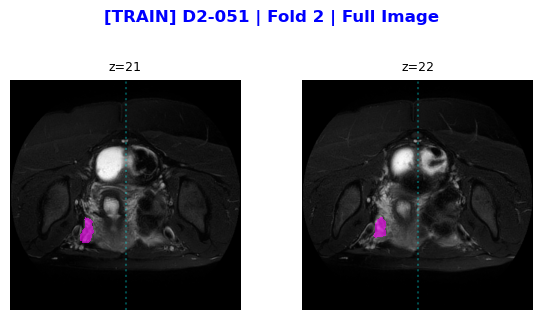

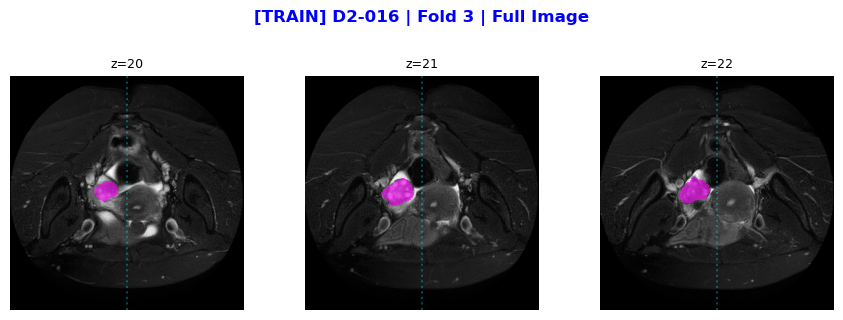

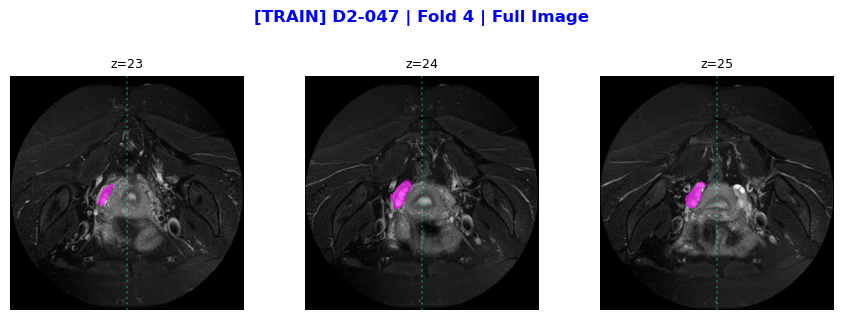

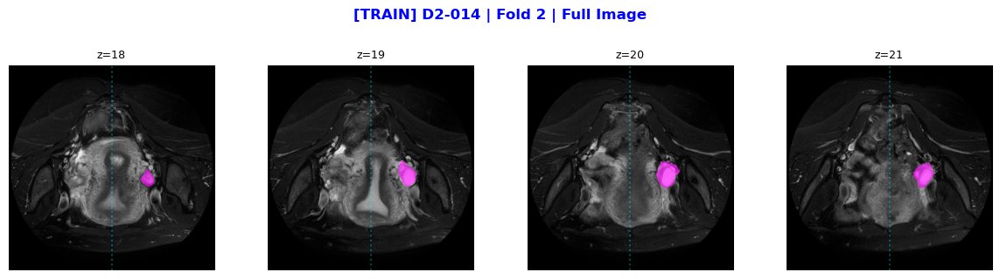

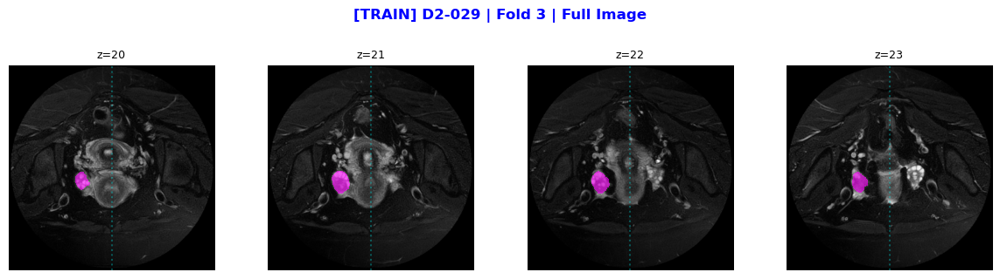

...

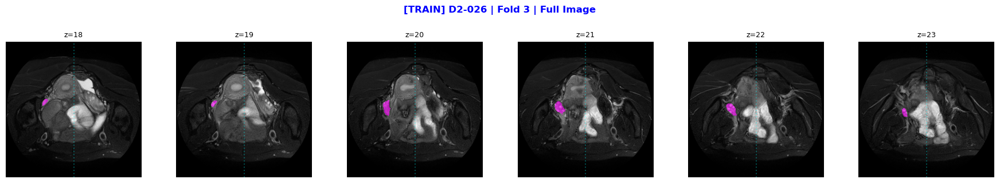

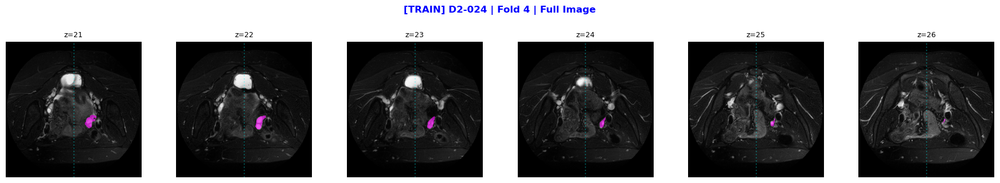

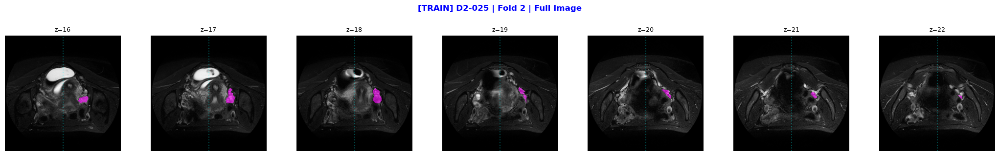

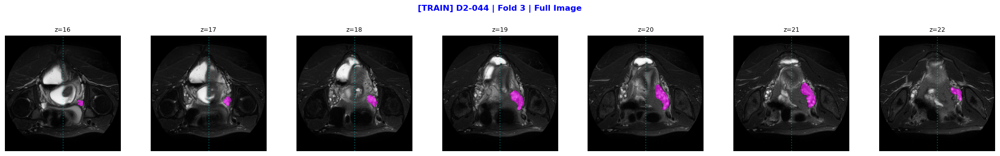

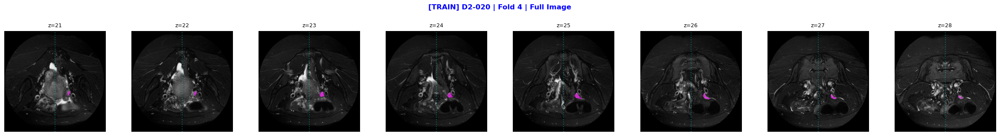


  VAL SET | Folds: [1] | Total Patients: 8



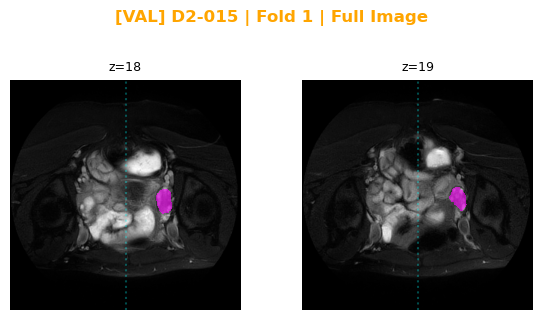

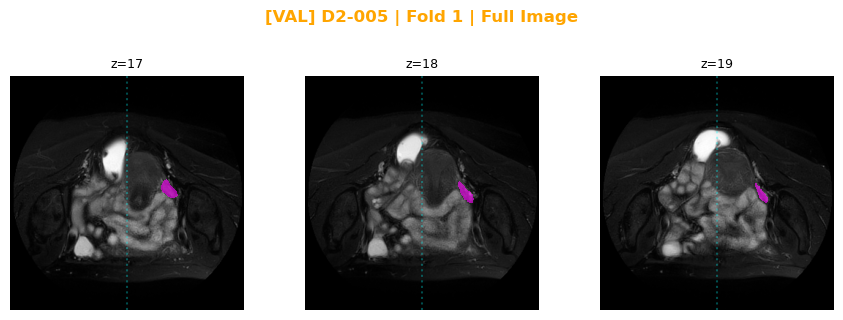

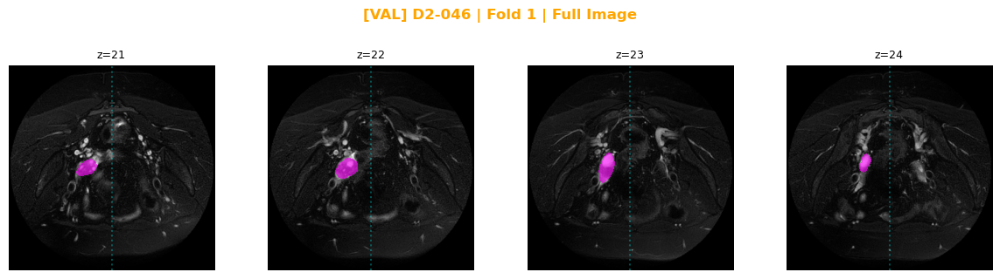

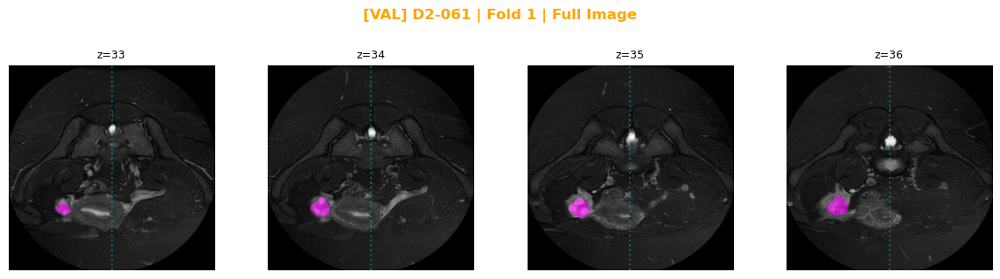

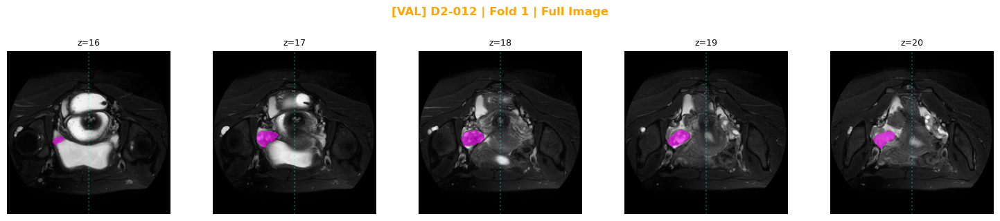

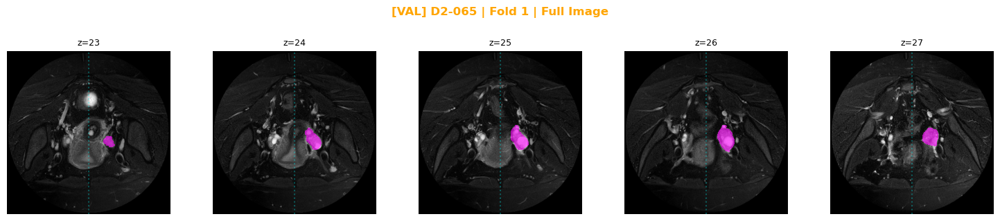

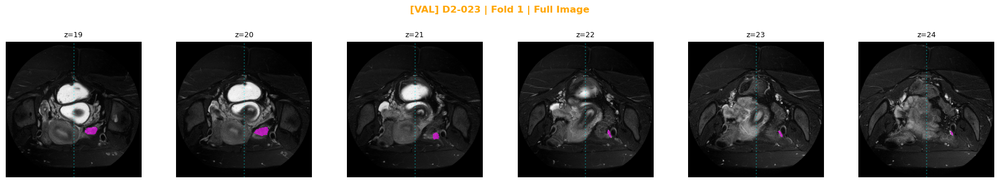

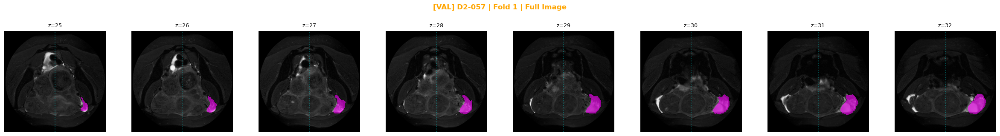


  TEST SET | Folds: [0] | Total Patients: 8



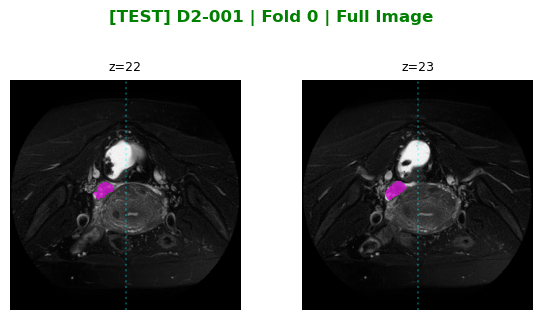

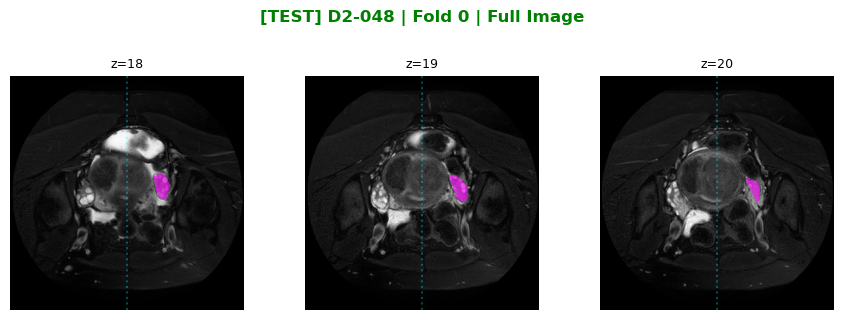

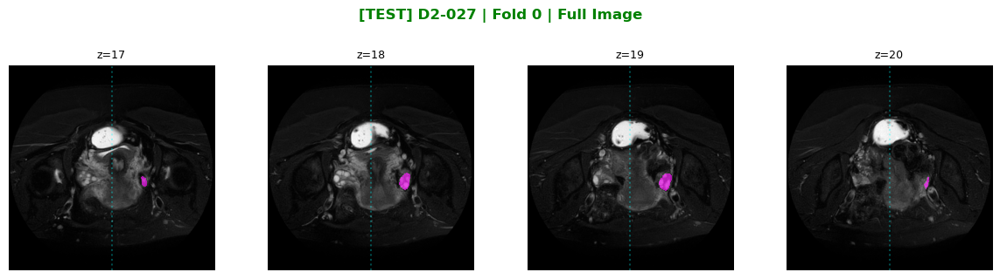

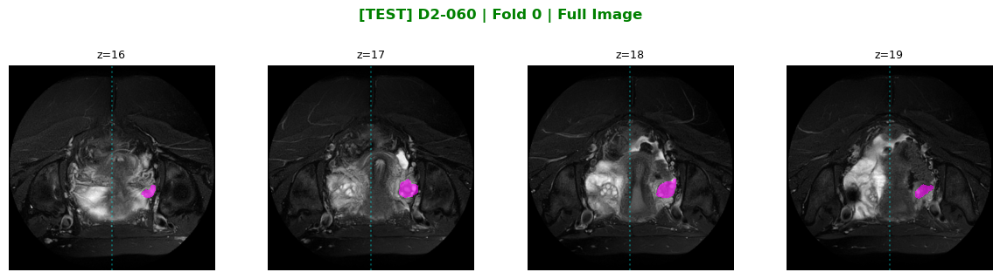

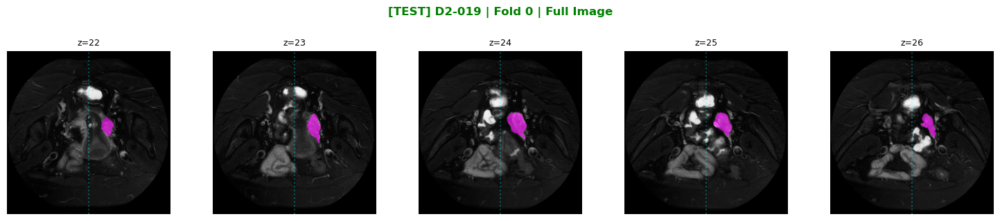

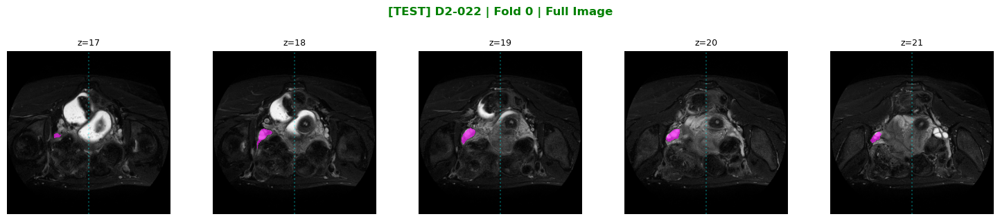

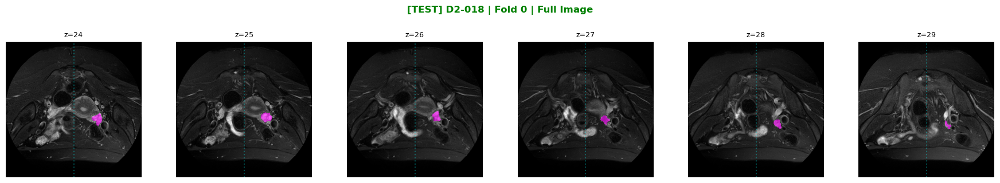

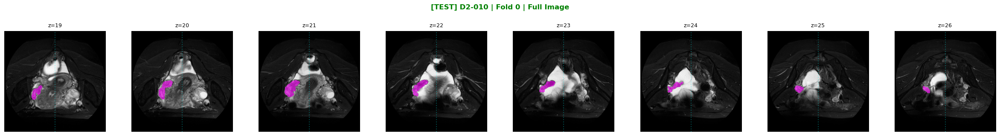

In [23]:
# Cell 12: Final Visual Audit of D2_Original
# Verifies that the control dataset contains FULL images (no blackout)
# and retains the correct Fold/Split assignments.

def visualize_original_splits(manifest_path):
    df = pd.read_csv(manifest_path)
    
    split_colors = {'train': 'blue', 'val': 'orange', 'test': 'green'}
    
    print(f"Visualizing CONTROL Dataset: {manifest_path}")
    
    for split in ['train', 'val', 'test']:
        subset = df[df['split'] == split]
        
        included_folds = sorted(subset['fold'].unique())
        folds_str = ", ".join(map(str, included_folds))
        
        print("\n" + "="*80)
        print(f"  {split.upper()} SET | Folds: [{folds_str}] | Total Patients: {len(subset)}")
        print("="*80 + "\n")
        
        for idx, row in subset.iterrows():
            pid = row['pid']
            fold_id = row['fold']
            
            # Handle metadata that might be missing in the original manifest
            side = row.get('original_side', 'N/A') 
            
            # Load from disk
            img_path = row['t2fs_path']
            msk_path = row['ov_path']
            
            if not Path(img_path).exists():
                 img_path = Path(manifest_path).parent / Path(img_path).name
                 msk_path = Path(manifest_path).parent / Path(msk_path).name
            
            img = nib.load(str(img_path)).get_fdata()
            msk = nib.load(str(msk_path)).get_fdata()
            mid = img.shape[0] // 2
            
            z_sums = np.sum(msk, axis=(0, 1))
            active_slices = np.where(z_sums > 0)[0]
            
            if len(active_slices) == 0:
                print(f"Skipping {pid} (No active slices)")
                continue
                
            if len(active_slices) > 8:
                start = len(active_slices) // 2 - 4
                display_slices = active_slices[start : start+8]
            else:
                display_slices = active_slices
                
            n_slices = len(display_slices)
            fig, axes = plt.subplots(1, n_slices, figsize=(3 * n_slices, 3))
            if n_slices == 1: axes = [axes]
            
            # Title
            fig.suptitle(f"[{split.upper()}] {pid} | Fold {fold_id} | Full Image", 
                         fontsize=12, y=1.05, color=split_colors[split], fontweight='bold')
            
            for ax, z_idx in zip(axes, display_slices):
                img_slice = img[:, :, z_idx]
                msk_slice = msk[:, :, z_idx]
                
                # Normalize
                img_disp = (img_slice - img_slice.min()) / (img_slice.max() - img_slice.min() + 1e-8)
                
                ax.imshow(img_disp.T, cmap='gray', origin='lower')
                
                masked_overlay = np.ma.masked_where(msk_slice.T == 0, msk_slice.T)
                ax.imshow(masked_overlay, cmap='spring', alpha=0.6, origin='lower')
                
                # We draw the midline just to prove the image extends past it
                ax.axvline(x=mid, color='cyan', linestyle=':', alpha=0.3)
                ax.set_title(f"z={z_idx}", fontsize=9)
                ax.axis('off')
                
            plt.tight_layout()
            plt.show()

# Run the audit on the NEW Original Manifest
original_manifest_loc = project_root / "data" / "UT-EndoMRI" / "D2_Original" / "d2_original_manifest.csv"
visualize_original_splits(original_manifest_loc)